In [1]:
# Loading the libraries data
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset
from torch.utils.data import DataLoader

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from tqdm import tqdm
from time import sleep
from os import listdir
import matplotlib.image as mpimg
from matplotlib.animation import FuncAnimation as FA
pd.set_option('display.max_columns', 50)
pd.set_option('display.max_rows', 50)

## Task 1: Load data

In [2]:
# Loading the data
train_df = pd.read_csv("../dat/train_FD001.txt", header=None, sep = ' ')
test_df = pd.read_csv("../dat/test_FD001.txt", header=None, sep = ' ')
rul_df = pd.read_csv("../dat/RUL_FD001.txt", header=None)

In [3]:
#display the top columns/rows
for df in [train_df, test_df, rul_df]:
    display(df.head(128))

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,21.61,554.36,2388.06,9046.19,1.3,47.47,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,NaN,NaN
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,21.61,553.75,2388.04,9044.07,1.3,47.49,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,NaN,NaN
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,554.26,2388.08,9052.94,1.3,47.27,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,NaN,NaN
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,554.45,2388.11,9049.48,1.3,47.13,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,NaN,NaN
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,554.00,2388.06,9055.15,1.3,47.28,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123,1,124,0.0025,0.0002,100.0,518.67,642.48,1587.14,1402.28,14.62,21.61,552.26,2388.13,9053.03,1.3,47.55,521.40,2388.13,8133.82,8.4416,0.03,393,2388,100.0,38.80,23.2341,NaN,NaN
124,1,125,-0.0004,0.0005,100.0,518.67,642.96,1585.47,1406.42,14.62,21.61,552.44,2388.13,9046.16,1.3,47.63,521.57,2388.11,8126.33,8.4079,0.03,394,2388,100.0,38.68,23.3039,NaN,NaN
125,1,126,0.0016,0.0001,100.0,518.67,642.49,1582.64,1418.50,14.62,21.61,553.72,2388.05,9049.11,1.3,47.49,521.35,2388.08,8130.94,8.4378,0.03,392,2388,100.0,38.85,23.2289,NaN,NaN
126,1,127,-0.0010,0.0002,100.0,518.67,642.99,1586.90,1399.49,14.62,21.61,553.81,2388.09,9047.90,1.3,47.63,521.34,2388.10,8133.00,8.4626,0.03,393,2388,100.0,38.91,23.2772,NaN,NaN


,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,21.61,553.90,2388.04,9050.17,1.3,47.20,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735,NaN,NaN
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,21.61,554.85,2388.01,9054.42,1.3,47.50,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916,NaN,NaN
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,21.61,554.11,2388.05,9056.96,1.3,47.50,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166,NaN,NaN
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,21.61,554.07,2388.03,9045.29,1.3,47.28,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737,NaN,NaN
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,21.61,554.16,2388.01,9044.55,1.3,47.31,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123,3,44,-0.0019,0.0000,100.0,518.67,642.16,1586.46,1410.72,14.62,21.61,552.95,2388.13,9055.43,1.3,47.59,521.77,2388.14,8133.77,8.4204,0.03,394,2388,100.0,38.74,23.3035,NaN,NaN
124,3,45,0.0003,-0.0004,100.0,518.67,642.55,1588.36,1405.75,14.62,21.61,552.30,2388.13,9058.30,1.3,47.57,521.00,2388.14,8125.84,8.4227,0.03,394,2388,100.0,38.86,23.3064,NaN,NaN
125,3,46,-0.0006,-0.0002,100.0,518.67,642.45,1587.99,1401.94,14.62,21.61,553.75,2388.09,9055.86,1.3,47.55,521.21,2388.09,8127.02,8.4210,0.03,393,2388,100.0,38.83,23.1494,NaN,NaN
126,3,47,0.0015,-0.0005,100.0,518.67,642.63,1587.05,1407.79,14.62,21.61,553.60,2388.14,9051.69,1.3,47.56,520.81,2388.11,8137.44,8.4516,0.03,394,2388,100.0,38.88,23.3113,NaN,NaN


,0
0,112
1,98
2,69
3,82
4,91
...,...
95,137
96,82
97,59
98,117


Let's review the descriptions of the columns in the csv files.

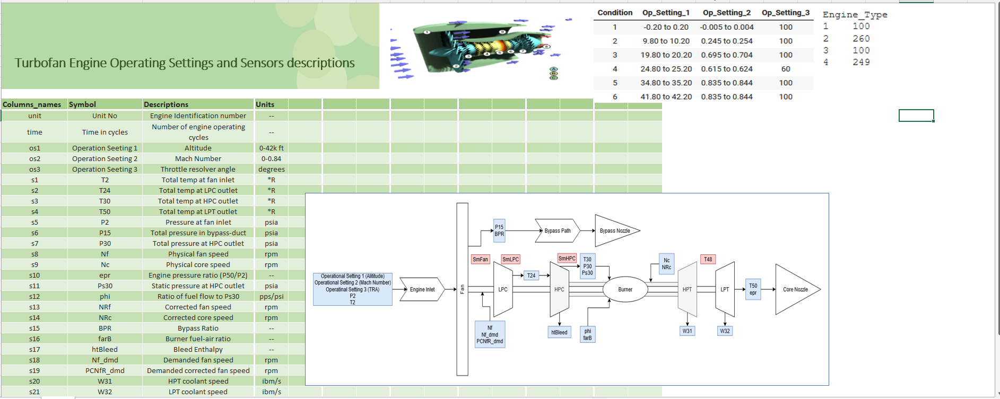

In [4]:
from IPython.display import Image, display

col_desc = '../dat/engine-settings-sensors-descriptions.png'
display(Image(col_desc))

Let's attach column names: 3 operational setting columns (os + number), and 21 sensor columns (s + number). 
Thereafter drop the last 2 columns with NaNs

In [5]:
col_names = []

col_names.append('unit')
col_names.append('time')

for i in range(1,4):
    col_names.append('os'+str(i))
for i in range(1,22):
    col_names.append('s'+str(i))

train_df = train_df.iloc[:,:-2].copy()
train_df.columns = col_names
display(train_df.head())

test_df = test_df.iloc[:,:-2].copy()
test_df.columns = col_names
display(test_df.head())

,unit,time,os1,os2,os3,s1,s2,s3,s4,s5,s6,s7,s8,s9,s10,s11,s12,s13,s14,s15,s16,s17,s18,s19,s20,s21
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,21.61,554.36,2388.06,9046.19,1.3,47.47,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,21.61,553.75,2388.04,9044.07,1.3,47.49,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,554.26,2388.08,9052.94,1.3,47.27,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,554.45,2388.11,9049.48,1.3,47.13,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,554.00,2388.06,9055.15,1.3,47.28,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044


,unit,time,os1,os2,os3,s1,s2,s3,s4,s5,s6,s7,s8,s9,s10,s11,s12,s13,s14,s15,s16,s17,s18,s19,s20,s21
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,21.61,553.90,2388.04,9050.17,1.3,47.20,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,21.61,554.85,2388.01,9054.42,1.3,47.50,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,21.61,554.11,2388.05,9056.96,1.3,47.50,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,21.61,554.07,2388.03,9045.29,1.3,47.28,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,21.61,554.16,2388.01,9044.55,1.3,47.31,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130


Let's attach the RUL (remaining useful lifetime) values to the datasets

In [6]:
rul_list = []

for n in np.arange(1,101):
    
    time_list = np.array(train_df[train_df['unit'] == n]['time'])
    length = len(time_list)
    rul = list(length - time_list)
    rul_list += rul
    
train_df['rul'] = rul_list

For the test data, we have the 'solutions' for the test engines in a separate file called rul_df (the name that I used for dataframe). 
I will use that to attach the RUL values for the test as well.

In [7]:

rul_list = []

for n in np.arange(1,101):
    
    time_list = np.array(test_df[test_df['unit'] == n]['time'])
    length = len(time_list)
    rul_val = rul_df.iloc[n-1].item()
    rul = list(length - time_list + rul_val)
    rul_list += rul

test_df['rul'] = rul_list

In [8]:
# Let's display the updated dataframes for train and test datasets with RULs

for df in [train_df, test_df]:
    display(df.head())



,unit,time,os1,os2,os3,s1,s2,s3,s4,s5,s6,s7,s8,s9,s10,s11,s12,s13,s14,s15,s16,s17,s18,s19,s20,s21,rul
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,21.61,554.36,2388.06,9046.19,1.3,47.47,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,191
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,21.61,553.75,2388.04,9044.07,1.3,47.49,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,190
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,21.61,554.26,2388.08,9052.94,1.3,47.27,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,189
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,21.61,554.45,2388.11,9049.48,1.3,47.13,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,188
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,21.61,554.00,2388.06,9055.15,1.3,47.28,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,187


,unit,time,os1,os2,os3,s1,s2,s3,s4,s5,s6,s7,s8,s9,s10,s11,s12,s13,s14,s15,s16,s17,s18,s19,s20,s21,rul
0,1,1,0.0023,0.0003,100.0,518.67,643.02,1585.29,1398.21,14.62,21.61,553.90,2388.04,9050.17,1.3,47.20,521.72,2388.03,8125.55,8.4052,0.03,392,2388,100.0,38.86,23.3735,142
1,1,2,-0.0027,-0.0003,100.0,518.67,641.71,1588.45,1395.42,14.62,21.61,554.85,2388.01,9054.42,1.3,47.50,522.16,2388.06,8139.62,8.3803,0.03,393,2388,100.0,39.02,23.3916,141
2,1,3,0.0003,0.0001,100.0,518.67,642.46,1586.94,1401.34,14.62,21.61,554.11,2388.05,9056.96,1.3,47.50,521.97,2388.03,8130.10,8.4441,0.03,393,2388,100.0,39.08,23.4166,140
3,1,4,0.0042,0.0000,100.0,518.67,642.44,1584.12,1406.42,14.62,21.61,554.07,2388.03,9045.29,1.3,47.28,521.38,2388.05,8132.90,8.3917,0.03,391,2388,100.0,39.00,23.3737,139
4,1,5,0.0014,0.0000,100.0,518.67,642.51,1587.19,1401.92,14.62,21.61,554.16,2388.01,9044.55,1.3,47.31,522.15,2388.03,8129.54,8.4031,0.03,390,2388,100.0,38.99,23.4130,138


## Task 2: Understand data

Our goal here is to predict the remaining useful life of the engine to schedule maintenance. 
To do this, we will want to identify the most important features for classification and maintenance prioritization. 

Before digging into each column, let's leverage `pandas_profiling`, to get a big picture of our data set. 

In [9]:
from pandas_profiling import ProfileReport

profile = ProfileReport(train_df, title="Pandas Profiling Engine Remaining Useful Life Report")

Let's show the report inside the notebook, go over the report and check each tab; especially the "Alerts". 

In [10]:
%%time
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

CPU times: user 3min 1s, sys: 2min 53s, total: 5min 54s
Wall time: 2min 15s


2. Pandas profiling Profile reports that there are 19 numeric variables and 8 categorical variables. Let's print out the datatype of each feature (column) and understand how the profiler infers data type.

In [11]:
train_df.dtypes

unit      int64
time      int64
os1     float64
os2     float64
os3     float64
s1      float64
s2      float64
s3      float64
s4      float64
s5      float64
s6      float64
s7      float64
s8      float64
s9      float64
s10     float64
s11     float64
s12     float64
s13     float64
s14     float64
s15     float64
s16     float64
s17       int64
s18       int64
s19     float64
s20     float64
s21     float64
rul       int64
dtype: object

3. From the report, we see that these 8 features `os3`, `s1`, `s5`, `s6`, `s10`, `s16`, `s18`, `s19` were "Rejected" as they have constant values for each column. 
These features are not informative, so we remove the 8 features from both the training and test sets. 


In [12]:
drop_cols1 = ['os3', 's1', 's5', 's6','s10', 's16', 's18', 's19'] 

train_df_reduced = train_df.drop(drop_cols1, axis = 1)
test_df_reduced = test_df.drop(drop_cols1, axis = 1)

for df in [train_df_reduced, test_df_reduced]:
    display(df.head())

,unit,time,os1,os2,s2,s3,s4,s7,s8,s9,s11,s12,s13,s14,s15,s17,s20,s21,rul
0,1,1,-0.0007,-0.0004,641.82,1589.70,1400.60,554.36,2388.06,9046.19,47.47,521.66,2388.02,8138.62,8.4195,392,39.06,23.4190,191
1,1,2,0.0019,-0.0003,642.15,1591.82,1403.14,553.75,2388.04,9044.07,47.49,522.28,2388.07,8131.49,8.4318,392,39.00,23.4236,190
2,1,3,-0.0043,0.0003,642.35,1587.99,1404.20,554.26,2388.08,9052.94,47.27,522.42,2388.03,8133.23,8.4178,390,38.95,23.3442,189
3,1,4,0.0007,0.0000,642.35,1582.79,1401.87,554.45,2388.11,9049.48,47.13,522.86,2388.08,8133.83,8.3682,392,38.88,23.3739,188
4,1,5,-0.0019,-0.0002,642.37,1582.85,1406.22,554.00,2388.06,9055.15,47.28,522.19,2388.04,8133.80,8.4294,393,38.90,23.4044,187


,unit,time,os1,os2,s2,s3,s4,s7,s8,s9,s11,s12,s13,s14,s15,s17,s20,s21,rul
0,1,1,0.0023,0.0003,643.02,1585.29,1398.21,553.90,2388.04,9050.17,47.20,521.72,2388.03,8125.55,8.4052,392,38.86,23.3735,142
1,1,2,-0.0027,-0.0003,641.71,1588.45,1395.42,554.85,2388.01,9054.42,47.50,522.16,2388.06,8139.62,8.3803,393,39.02,23.3916,141
2,1,3,0.0003,0.0001,642.46,1586.94,1401.34,554.11,2388.05,9056.96,47.50,521.97,2388.03,8130.10,8.4441,393,39.08,23.4166,140
3,1,4,0.0042,0.0000,642.44,1584.12,1406.42,554.07,2388.03,9045.29,47.28,521.38,2388.05,8132.90,8.3917,391,39.00,23.3737,139
4,1,5,0.0014,0.0000,642.51,1587.19,1401.92,554.16,2388.01,9044.55,47.31,522.15,2388.03,8129.54,8.4031,390,38.99,23.4130,138


In [13]:
train_df_reduced.shape

(20631, 19)

In [14]:
test_df_reduced.shape

(13096, 19)

## Task 3: Preprocess Data

5. Let's visualize the selected features relationship as the engine progresses toward failure. 

In [15]:
sample_df = train_df_reduced[train_df_reduced['unit'] == 4].copy()

fig, axes = plt.subplots(6,3, figsize=(15,25))
fig.tight_layout()

j = -1
for c in train_df_reduced.columns:
    
    if 's' in c:
        j += 1
        axes[j // 3, j % 3].plot(sample_df['time'], sample_df[c])
        axes[j // 3, j % 3].set_title(c)

## Task 4: Build Baseline Regression Models

1. Make the NumPy arrays `X_train`, `X_test`, `y_train` and `y_test` from `train_df_reduced` and `test_df_reduced`.

In [16]:
y_train = train_df_reduced['rul'].values
y_test = test_df_reduced['rul'].values 
X_train = train_df_reduced.drop(['rul','time','unit'], axis = 1).values
X_test = test_df_reduced.drop(['rul','time','unit'], axis = 1).values

In [17]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import (mean_squared_error, r2_score)
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

LinearRegression()

In [18]:
lr_pred = lr_model.predict(X_test)

In [19]:
lr_model.score(X_test, y_test)

0.3270297901378425

In [20]:
print("Mean squared error: %.2f" % mean_squared_error(y_test, lr_pred))

print("Coefficient of determination: %.2f" % r2_score(y_test, lr_pred))

Mean squared error: 2340.85
Coefficient of determination: 0.33


2. Let's Min-max scale the sensor value values using MinMaxScaler 

In [21]:
minmax_dict = {}

for c in train_df_reduced.columns:
    if 's' in c:
        minmax_dict[c+'min'] = train_df_reduced[c].min()
        minmax_dict[c+'max']=  train_df_reduced[c].max()
        
for c in train_df_reduced.columns:
    if 's' in c:
        train_df_reduced[c] = (train_df_reduced[c] - minmax_dict[c+'min']) / (minmax_dict[c+'max'] - minmax_dict[c+'min'])
        
for c in test_df_reduced.columns:
    if 's' in c:
        test_df_reduced[c] = (test_df_reduced[c] - minmax_dict[c+'min']) / (minmax_dict[c+'max'] - minmax_dict[c+'min'])
        
for df in [train_df_reduced, test_df_reduced]:
    display(df.head())

,unit,time,os1,os2,s2,s3,s4,s7,s8,s9,s11,s12,s13,s14,s15,s17,s20,s21,rul
0,1,1,0.459770,0.166667,0.183735,0.406802,0.309757,0.726248,0.242424,0.109755,0.369048,0.633262,0.205882,0.199608,0.363986,0.333333,0.713178,0.724662,191
1,1,2,0.609195,0.250000,0.283133,0.453019,0.352633,0.628019,0.212121,0.100242,0.380952,0.765458,0.279412,0.162813,0.411312,0.333333,0.666667,0.731014,190
2,1,3,0.252874,0.750000,0.343373,0.369523,0.370527,0.710145,0.272727,0.140043,0.250000,0.795309,0.220588,0.171793,0.357445,0.166667,0.627907,0.621375,189
3,1,4,0.540230,0.500000,0.343373,0.256159,0.331195,0.740741,0.318182,0.124518,0.166667,0.889126,0.294118,0.174889,0.166603,0.333333,0.573643,0.662386,188
4,1,5,0.390805,0.333333,0.349398,0.257467,0.404625,0.668277,0.242424,0.149960,0.255952,0.746269,0.235294,0.174734,0.402078,0.416667,0.589147,0.704502,187


,unit,time,os1,os2,s2,s3,s4,s7,s8,s9,s11,s12,s13,s14,s15,s17,s20,s21,rul
0,1,1,0.632184,0.750000,0.545181,0.310661,0.269413,0.652174,0.212121,0.127614,0.208333,0.646055,0.220588,0.132160,0.308965,0.333333,0.558140,0.661834,142
1,1,2,0.344828,0.250000,0.150602,0.379551,0.222316,0.805153,0.166667,0.146684,0.386905,0.739872,0.264706,0.204768,0.213159,0.416667,0.682171,0.686827,141
2,1,3,0.517241,0.583333,0.376506,0.346632,0.322248,0.685990,0.227273,0.158081,0.386905,0.699360,0.220588,0.155640,0.458638,0.416667,0.728682,0.721348,140
3,1,4,0.741379,0.500000,0.370482,0.285154,0.408001,0.679549,0.196970,0.105717,0.255952,0.573561,0.250000,0.170090,0.257022,0.250000,0.666667,0.662110,139
4,1,5,0.580460,0.500000,0.391566,0.352082,0.332039,0.694042,0.166667,0.102396,0.273810,0.737740,0.220588,0.152751,0.300885,0.166667,0.658915,0.716377,138


## Time Series Preprocessing For Sensor Values Using Exponentially Weighted Average

In [22]:
#Smoothing Function: Exponentially Weighted Averages

def smooth(s, b = 0.98):

    v = np.zeros(len(s)+1) #v_0 is already 0.
    bc = np.zeros(len(s)+1)

    for i in range(1, len(v)): #v_t = 0.95
        v[i] = (b * v[i-1] + (1-b) * s[i-1]) 
        bc[i] = 1 - b**i

    sm = v[1:] / bc[1:]
    
    return sm

s = [1,2,3,4,5]
print(s)
print(f'After Smoothing: {smooth(s)}')

[1, 2, 3, 4, 5]
After Smoothing: [1.         1.50505051 2.01346756 2.52525046 3.04039827]


In [23]:
#Smoothing each time series for each engine in both training and test sets

for c in train_df_reduced.columns:
    
    if 's' in c:
        sm_list = []

        for n in np.arange(1,101):
            s = np.array(train_df_reduced[train_df_reduced['unit'] == n][c].copy())
            sm = list(smooth(s, 0.98))
            sm_list += sm
        
        train_df_reduced[c+'_smoothed'] = sm_list
        
for c in test_df_reduced.columns:
    
    if 's' in c:
        sm_list = []

        for n in np.arange(1,101):
            s = np.array(test_df_reduced[test_df_reduced['unit'] == n][c].copy())
            sm = list(smooth(s, 0.98))
            sm_list += sm
        
        test_df_reduced[c+'_smoothed'] = sm_list

Let's take a look at how smoothed values (salmon) look compared to the original series (lightblue), for a particular sensor (unit 10 from train)

In [24]:
sample_df_ten = train_df_reduced[train_df_reduced['unit'] == 10].copy()

fig, axes = plt.subplots(6,3, figsize = (15,25))
fig.tight_layout()

j = -1
for c in train_df_reduced.columns:
    
    if ('s' in c) and ('smoothed' not in c):
        j += 1
        axes[j // 3, j % 3].plot(sample_df_ten['time'], sample_df_ten[c], c = 'lightblue', label = 'original')
        axes[j // 3, j % 3].plot(sample_df_ten['time'], sample_df_ten[c+'_smoothed'], c = 'salmon', label = 'smoothed')
        axes[j // 3, j % 3].plot([10,10],[0,1], c = 'black')
        axes[j // 3, j % 3].set_title(c)
        axes[j // 3, j % 3].legend()

In [25]:
#Remove the original series

for c in train_df_reduced.columns:
    if ('s' in c) and ('smoothed' not in c):
        train_df_reduced[c] = train_df_reduced[c+'_smoothed']
        train_df_reduced.drop(c+'_smoothed', axis = 1, inplace = True)
        
for c in test_df_reduced.columns:
    if ('s' in c) and ('smoothed' not in c):
        test_df_reduced[c] = test_df_reduced[c+'_smoothed']
        test_df_reduced.drop(c+'_smoothed', axis = 1, inplace = True)
        
for df in [train_df_reduced, test_df_reduced]:
    display(df.head())

,unit,time,os1,os2,s2,s3,s4,s7,s8,s9,s11,s12,s13,s14,s15,s17,s20,s21,rul
0,1,1,0.459770,0.166667,0.183735,0.406802,0.309757,0.726248,0.242424,0.109755,0.369048,0.633262,0.205882,0.199608,0.363986,0.333333,0.713178,0.724662,191
1,1,2,0.535237,0.208754,0.233936,0.430144,0.331412,0.676638,0.227120,0.104951,0.375060,0.700028,0.243018,0.181025,0.387888,0.333333,0.689688,0.727870,190
2,1,3,0.439208,0.392826,0.271154,0.409527,0.344714,0.688033,0.242630,0.116885,0.332528,0.732432,0.235390,0.177885,0.377535,0.276652,0.668677,0.691652,189
3,1,4,0.465234,0.420437,0.289760,0.370016,0.341231,0.701612,0.262094,0.118852,0.289798,0.772801,0.250520,0.177113,0.323193,0.291254,0.644194,0.684112,188
4,1,5,0.449741,0.402305,0.302174,0.346587,0.354428,0.694673,0.258000,0.125327,0.282753,0.767278,0.247350,0.176618,0.339614,0.317360,0.632735,0.688357,187


,unit,time,os1,os2,s2,s3,s4,s7,s8,s9,s11,s12,s13,s14,s15,s17,s20,s21,rul
0,1,1,0.632184,0.750000,0.545181,0.310661,0.269413,0.652174,0.212121,0.127614,0.208333,0.646055,0.220588,0.132160,0.308965,0.333333,0.558140,0.661834,142
1,1,2,0.487054,0.497475,0.345899,0.345454,0.245626,0.729436,0.189164,0.137245,0.298521,0.693438,0.242870,0.168831,0.260578,0.375421,0.620781,0.674457,141
2,1,3,0.497321,0.526674,0.356308,0.345854,0.271685,0.714661,0.202125,0.144331,0.328579,0.695452,0.235292,0.164345,0.327936,0.389448,0.657477,0.690404,140
3,1,4,0.560197,0.519802,0.359960,0.330216,0.306804,0.705615,0.200797,0.134383,0.309869,0.664050,0.239081,0.165825,0.309667,0.353523,0.659845,0.683115,139
4,1,5,0.564415,0.515680,0.366539,0.334768,0.312057,0.703206,0.193692,0.127725,0.302363,0.679389,0.235232,0.163103,0.307839,0.314626,0.659651,0.690038,138


 When we look at the length of the trajectories for each unit in both the training and test sets, thus 200 engines, we see that for the training set that had the entire trajectories, have minimum length of 128. However, for the test set, we have a minimum value of 31. This means that if we were to predict the final RUL for every test engine unit, we cannot use a window size greater than 31 for training the model. Furthermore, if you take a look at the smoothed series visualization, I put a black vertical line for every graph, at about time step 10. This is because, when we smooth using exponentially weighted averages, seems like in the beginning, the smoothing process is sort of 'warming up'? So it seems a little shaky. Thus, I will be taking that part out of the training process. This will happen for test data as well. Thus, the maximum window size we can take is 31 - 10 = 21. I will go with 20.

In [26]:
print('training set time cycles:')
display(train_df_reduced.groupby('unit')['time'].max().describe())
print('test set time cycles:')
display(test_df_reduced.groupby('unit')['time'].max().describe())

training set time cycles:


count    100.000000
mean     206.310000
std       46.342749
min      128.000000
25%      177.000000
50%      199.000000
75%      229.250000
max      362.000000
Name: time, dtype: float64

test set time cycles:


count    100.000000
mean     130.960000
std       53.593479
min       31.000000
25%       88.750000
50%      133.500000
75%      164.250000
max      303.000000
Name: time, dtype: float64

In [27]:
n_features = len([c for c in train_df_reduced.columns if 's' in c])
window = 20
print(f'number of features: {n_features}, window size: {window}')

number of features: 16, window size: 20


7. Make the NumPy arrays `X_train`, `X_test`, `y_train` and `y_test` from `train_df` and `test_df`.

In [28]:
y_train = train_df_reduced['rul'].values
y_test = test_df_reduced['rul'].values 
X_train = train_df_reduced.drop(['rul','time','unit'], axis = 1).values
X_test = test_df_reduced.drop(['rul','time','unit'], axis = 1).values

In [29]:
X_train

array([[0.45977011, 0.16666667, 0.18373494, ..., 0.33333333, 0.71317829,
        0.7246617 ],
       [0.53523743, 0.20875421, 0.23393574, ..., 0.33333333, 0.68968757,
        0.72786969],
       [0.43920836, 0.39282637, 0.2711544 , ..., 0.2766517 , 0.66867662,
        0.69165204],
       ...,
       [0.49253124, 0.44406389, 0.55993871, ..., 0.54841772, 0.38586145,
        0.41069304],
       [0.49139587, 0.45029443, 0.56092633, ..., 0.5491288 , 0.38037127,
        0.40710408],
       [0.48782702, 0.44282382, 0.5656953 , ..., 0.55152164, 0.37625738,
        0.40325779]])

## Task 4: Build Baseline Regression Model after Time Series Preprocessing

1. Let's start with a simple Linear Regression model

In [30]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import (mean_squared_error, r2_score)
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)

LinearRegression()

In [31]:
lr_pred = lr_model.predict(X_test)

2. Let's calculate the metrics for the LinearRegression model. 

In [32]:
lr_model.intercept_

81.10844484583285

In [33]:
pd.DataFrame(zip(train_df_reduced.drop(['rul','time','unit'], axis = 1).columns, 
                 np.transpose(lr_model.coef_)), columns=['features', 'coef'])

,features,coef
0,os1,137.323391
1,os2,18.099619
2,s2,-76.446632
3,s3,-272.821495
4,s4,-313.700154
5,s7,31.101911
6,s8,259.566258
7,s9,271.958689
8,s11,-146.294102
9,s12,-14.860937


In [34]:
lr_model.score(X_test, y_test)

0.1746969150197034

In [35]:
print("Mean squared error: %.2f" % mean_squared_error(y_test, lr_pred))

print("Coefficient of determination: %.2f" % r2_score(y_test, lr_pred))

Mean squared error: 2870.72
Coefficient of determination: 0.17


2. Let's try a Random Forest Regressor model

In [36]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_regression
from sklearn.metrics import (mean_squared_error, r2_score)
rfr_model = RandomForestRegressor()
rfr_model.fit(X_train, y_train)

RandomForestRegressor()

In [37]:
rfr_pred = rfr_model.predict(X_test)

3. Let's calculate the metrics for the RandomForestRegressor model. 

In [38]:
rfr_model.score(X_test, y_test)

0.09911034014138498

In [39]:
print("Mean squared error: %.2f" % mean_squared_error(y_test, rfr_pred))

print("Coefficient of determination: %.2f" % r2_score(y_test, rfr_pred))

Mean squared error: 3133.64
Coefficient of determination: 0.10


## Classification Models

In [40]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [41]:
drop_cols1 = ['os3', 's1', 's5', 's6','s10', 's16', 's18', 's19'] 

train_df_reduced_class = train_df.drop(drop_cols1, axis = 1)
test_df_reduced_class = test_df.drop(drop_cols1, axis = 1)

for df in [train_df_reduced_class, test_df_reduced_class]:
    display(df.head())

,unit,time,os1,os2,s2,s3,s4,s7,s8,s9,s11,s12,s13,s14,s15,s17,s20,s21,rul
0,1,1,-0.0007,-0.0004,641.82,1589.70,1400.60,554.36,2388.06,9046.19,47.47,521.66,2388.02,8138.62,8.4195,392,39.06,23.4190,191
1,1,2,0.0019,-0.0003,642.15,1591.82,1403.14,553.75,2388.04,9044.07,47.49,522.28,2388.07,8131.49,8.4318,392,39.00,23.4236,190
2,1,3,-0.0043,0.0003,642.35,1587.99,1404.20,554.26,2388.08,9052.94,47.27,522.42,2388.03,8133.23,8.4178,390,38.95,23.3442,189
3,1,4,0.0007,0.0000,642.35,1582.79,1401.87,554.45,2388.11,9049.48,47.13,522.86,2388.08,8133.83,8.3682,392,38.88,23.3739,188
4,1,5,-0.0019,-0.0002,642.37,1582.85,1406.22,554.00,2388.06,9055.15,47.28,522.19,2388.04,8133.80,8.4294,393,38.90,23.4044,187


,unit,time,os1,os2,s2,s3,s4,s7,s8,s9,s11,s12,s13,s14,s15,s17,s20,s21,rul
0,1,1,0.0023,0.0003,643.02,1585.29,1398.21,553.90,2388.04,9050.17,47.20,521.72,2388.03,8125.55,8.4052,392,38.86,23.3735,142
1,1,2,-0.0027,-0.0003,641.71,1588.45,1395.42,554.85,2388.01,9054.42,47.50,522.16,2388.06,8139.62,8.3803,393,39.02,23.3916,141
2,1,3,0.0003,0.0001,642.46,1586.94,1401.34,554.11,2388.05,9056.96,47.50,521.97,2388.03,8130.10,8.4441,393,39.08,23.4166,140
3,1,4,0.0042,0.0000,642.44,1584.12,1406.42,554.07,2388.03,9045.29,47.28,521.38,2388.05,8132.90,8.3917,391,39.00,23.3737,139
4,1,5,0.0014,0.0000,642.51,1587.19,1401.92,554.16,2388.01,9044.55,47.31,522.15,2388.03,8129.54,8.4031,390,38.99,23.4130,138


In [42]:
train_df_reduced_class['high_risk'] = train_df_reduced_class['rul'] <= 10
test_df_reduced_class['high_risk'] = test_df_reduced_class['rul'] <= 10

In [43]:
train_df_reduced_class['high_risk'].sum()

1100

In [44]:
train_df_reduced_class['med_risk'] = train_df_reduced_class['rul'].apply(lambda x: 1 if 10 < x < 20 else 0).fillna(0)
test_df_reduced_class['med_risk'] = test_df_reduced_class['rul'].apply(lambda x: 1 if 10 < x < 20 else 0).fillna(0)

In [45]:
train_df_reduced_class['med_risk'].sum()

900

In [46]:
train_df_reduced_class['low_risk'] = train_df_reduced_class['rul'] > 20
test_df_reduced_class['low_risk'] = test_df_reduced_class['rul'] > 20

In [47]:
train_df_reduced_class['low_risk'].sum()

18531

In [48]:
for df in [train_df_reduced_class, test_df_reduced_class]:
    display(df.head(128))

,unit,time,os1,os2,s2,s3,s4,s7,s8,s9,s11,s12,s13,s14,s15,s17,s20,s21,rul,high_risk,med_risk,low_risk
0,1,1,-0.0007,-0.0004,641.82,1589.70,1400.60,554.36,2388.06,9046.19,47.47,521.66,2388.02,8138.62,8.4195,392,39.06,23.4190,191,False,0,True
1,1,2,0.0019,-0.0003,642.15,1591.82,1403.14,553.75,2388.04,9044.07,47.49,522.28,2388.07,8131.49,8.4318,392,39.00,23.4236,190,False,0,True
2,1,3,-0.0043,0.0003,642.35,1587.99,1404.20,554.26,2388.08,9052.94,47.27,522.42,2388.03,8133.23,8.4178,390,38.95,23.3442,189,False,0,True
3,1,4,0.0007,0.0000,642.35,1582.79,1401.87,554.45,2388.11,9049.48,47.13,522.86,2388.08,8133.83,8.3682,392,38.88,23.3739,188,False,0,True
4,1,5,-0.0019,-0.0002,642.37,1582.85,1406.22,554.00,2388.06,9055.15,47.28,522.19,2388.04,8133.80,8.4294,393,38.90,23.4044,187,False,0,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123,1,124,0.0025,0.0002,642.48,1587.14,1402.28,552.26,2388.13,9053.03,47.55,521.40,2388.13,8133.82,8.4416,393,38.80,23.2341,68,False,0,True
124,1,125,-0.0004,0.0005,642.96,1585.47,1406.42,552.44,2388.13,9046.16,47.63,521.57,2388.11,8126.33,8.4079,394,38.68,23.3039,67,False,0,True
125,1,126,0.0016,0.0001,642.49,1582.64,1418.50,553.72,2388.05,9049.11,47.49,521.35,2388.08,8130.94,8.4378,392,38.85,23.2289,66,False,0,True
126,1,127,-0.0010,0.0002,642.99,1586.90,1399.49,553.81,2388.09,9047.90,47.63,521.34,2388.10,8133.00,8.4626,393,38.91,23.2772,65,False,0,True


,unit,time,os1,os2,s2,s3,s4,s7,s8,s9,s11,s12,s13,s14,s15,s17,s20,s21,rul,high_risk,med_risk,low_risk
0,1,1,0.0023,0.0003,643.02,1585.29,1398.21,553.90,2388.04,9050.17,47.20,521.72,2388.03,8125.55,8.4052,392,38.86,23.3735,142,False,0,True
1,1,2,-0.0027,-0.0003,641.71,1588.45,1395.42,554.85,2388.01,9054.42,47.50,522.16,2388.06,8139.62,8.3803,393,39.02,23.3916,141,False,0,True
2,1,3,0.0003,0.0001,642.46,1586.94,1401.34,554.11,2388.05,9056.96,47.50,521.97,2388.03,8130.10,8.4441,393,39.08,23.4166,140,False,0,True
3,1,4,0.0042,0.0000,642.44,1584.12,1406.42,554.07,2388.03,9045.29,47.28,521.38,2388.05,8132.90,8.3917,391,39.00,23.3737,139,False,0,True
4,1,5,0.0014,0.0000,642.51,1587.19,1401.92,554.16,2388.01,9044.55,47.31,522.15,2388.03,8129.54,8.4031,390,38.99,23.4130,138,False,0,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
123,3,44,-0.0019,0.0000,642.16,1586.46,1410.72,552.95,2388.13,9055.43,47.59,521.77,2388.14,8133.77,8.4204,394,38.74,23.3035,151,False,0,True
124,3,45,0.0003,-0.0004,642.55,1588.36,1405.75,552.30,2388.13,9058.30,47.57,521.00,2388.14,8125.84,8.4227,394,38.86,23.3064,150,False,0,True
125,3,46,-0.0006,-0.0002,642.45,1587.99,1401.94,553.75,2388.09,9055.86,47.55,521.21,2388.09,8127.02,8.4210,393,38.83,23.1494,149,False,0,True
126,3,47,0.0015,-0.0005,642.63,1587.05,1407.79,553.60,2388.14,9051.69,47.56,520.81,2388.11,8137.44,8.4516,394,38.88,23.3113,148,False,0,True


Make the NumPy arrays `X_train_class`, `X_test_class`, `y_train` and `y_test` from `train_df_reduced_class` and `test_df_reduced_class`. 

In [49]:
y_train_high = train_df_reduced_class['high_risk'].values
y_test_high = test_df_reduced_class['high_risk'].values   
y_train_med = train_df_reduced_class['med_risk'].values
y_test_med = test_df_reduced_class['med_risk'].values 
y_train_low = train_df_reduced_class['low_risk'].values
y_test_low = test_df_reduced_class['low_risk'].values 

X_train_class = train_df_reduced_class.drop(columns=['high_risk','med_risk','low_risk', 'rul', 'unit', 'time']).values
X_test_class = test_df_reduced_class.drop(columns=['high_risk','med_risk','low_risk', 'rul', 'unit', 'time']).values

Scale the features in `X_train_class` and `X_test_class` use `MinMaxScaler`

In [50]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
#scaler = MinMaxScaler() 
scaler = StandardScaler()
X_train_cs = scaler.fit_transform(X_train_class) 
X_test_cs = scaler.fit_transform(X_test_class)

## Build Logistic Regression, SVM and Gradient Boosting models

In [51]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC

from sklearn.metrics import (
    confusion_matrix,
    accuracy_score as accuracy,
    recall_score as recall,
    precision_score as precision,
    f1_score
)

In [52]:
y_train_high = train_df_reduced_class['high_risk'].values

In [53]:
y_train_high

array([False, False, False, ...,  True,  True,  True])

In [54]:
%%time
lr_model = LogisticRegression(random_state=13, class_weight='balanced') 
lr_model.fit(X_train_cs, y_train_high)

CPU times: user 688 ms, sys: 1.62 s, total: 2.3 s
Wall time: 306 ms


LogisticRegression(class_weight='balanced', random_state=13)

In [55]:
lr_pred = lr_model.predict(X_test_cs)

In [56]:
print("accuracy:", accuracy(y_test_high, lr_pred))
print("precision:", precision(y_test_high, lr_pred))
print("recall:", recall(y_test_high, lr_pred, zero_division=1.0))
print("f1 score:", f1_score(y_test_high, lr_pred))
print("confusion matrix:")
print(confusion_matrix(y_test_high, lr_pred))

accuracy: 0.953191814294441
precision: 0.026984126984126985
recall: 1.0
f1 score: 0.052550231839258124
confusion matrix:
[[12466   613]
 [    0    17]]


In [57]:
y_train_med = train_df_reduced_class['med_risk'].values


lr_model2 = LogisticRegression(random_state=13, class_weight='balanced') 
lr_model2.fit(X_train_cs, y_train_med)

lr_pred2 = lr_model2.predict(X_test_cs)

In [58]:
print("accuracy:", accuracy(y_test_med, lr_pred2))
print("precision:", precision(y_test_med, lr_pred2))
print("recall:", recall(y_test_med, lr_pred2, zero_division=1.0))
print("f1 score:", f1_score(y_test_med, lr_pred2))
print("confusion matrix:")
print(confusion_matrix(y_test_med, lr_pred2))

accuracy: 0.9002748930971289
precision: 0.06446991404011461
recall: 1.0
f1 score: 0.12113055181695827
confusion matrix:
[[11700  1306]
 [    0    90]]


In [59]:
y_train_low = train_df_reduced_class['low_risk'].values


lr_model3 = LogisticRegression(random_state=13, class_weight='balanced') 
lr_model3.fit(X_train_cs, y_train_low)

lr_pred3 = lr_model3.predict(X_test_cs)

In [60]:
print("accuracy:", accuracy(y_test_low, lr_pred3))
print("precision:", precision(y_test_low, lr_pred3))
print("recall:", recall(y_test_low, lr_pred3, zero_division=1.0))
print("f1 score:", f1_score(y_test_low, lr_pred3))
print("confusion matrix:")
print(confusion_matrix(y_test_low, lr_pred3))

accuracy: 0.9179138668295663
precision: 1.0
recall: 0.9171355893008556
f1 score: 0.9567769691608701
confusion matrix:
[[  123     0]
 [ 1075 11898]]


In [61]:
%%time
from sklearn.svm import LinearSVC
svm_model = LinearSVC() 
svm_model.fit(X_train_cs, y_train_high)
svm_pred = svm_model.predict(X_test_cs)

CPU times: user 294 ms, sys: 26.1 ms, total: 320 ms
Wall time: 265 ms


/home/williams/.local/lib/python3.10/site-packages/sklearn/svm/_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


In [69]:
print("accuracy:", accuracy(y_test_high, svm_pred))
print("precision:", precision(y_test_high, svm_pred))
print("recall:", recall(y_test_high, svm_pred, zero_division=1.0))
print("f1 score:", f1_score(y_test_high, svm_pred))
print("confusion matrix:")
print(confusion_matrix(y_test_high, svm_pred))

accuracy: 0.9729688454489921
precision: 0.04582210242587601
recall: 1.0
f1 score: 0.08762886597938144
confusion matrix:
[[12725   354]
 [    0    17]]


In [70]:
svm_model2 = LinearSVC() 
svm_model2.fit(X_train_cs, y_train_med)
svm_pred2 = svm_model2.predict(X_test_cs)

/home/williams/.local/lib/python3.10/site-packages/sklearn/svm/_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


In [71]:
print("accuracy:", accuracy(y_test_med, svm_pred2))
print("precision:", precision(y_test_med, svm_pred2))
print("recall:", recall(y_test_med, svm_pred2, zero_division=1.0))
print("f1 score:", f1_score(y_test_med, svm_pred2))
print("confusion matrix:")
print(confusion_matrix(y_test_med, svm_pred2))

accuracy: 0.9931276725717776
precision: 0.5
recall: 0.022222222222222223
f1 score: 0.0425531914893617
confusion matrix:
[[13004     2]
 [   88     2]]


In [72]:
svm_model3 = LinearSVC() 
svm_model3.fit(X_train_cs, y_train_low)
svm_pred3 = svm_model3.predict(X_test_cs)

/home/williams/.local/lib/python3.10/site-packages/sklearn/svm/_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


In [73]:
print("accuracy:", accuracy(y_test_low, svm_pred3))
print("precision:", precision(y_test_low, svm_pred3))
print("recall:", recall(y_test_low, svm_pred3, zero_division=1.0))
print("f1 score:", f1_score(y_test_low, svm_pred3))
print("confusion matrix:")
print(confusion_matrix(y_test_low, svm_pred3))

accuracy: 0.9543372021991448
precision: 0.9997576932396414
recall: 0.9541355122176829
f1 score: 0.9764139780705213
confusion matrix:
[[  120     3]
 [  595 12378]]


In [74]:
from sklearn.ensemble import GradientBoostingClassifier

In [75]:
%%time
gbt_model = GradientBoostingClassifier()  
gbt_model.fit(X_train_cs, y_train_high)
gbt_pred = gbt_model.predict(X_test_cs)

CPU times: user 11.1 s, sys: 0 ns, total: 11.1 s
Wall time: 11.1 s


In [76]:
print("accuracy:", accuracy(y_test_high, gbt_pred))
print("precision:", precision(y_test_high, gbt_pred))
print("recall:", recall(y_test_high, gbt_pred, zero_division=1.0))
print("f1 score:", f1_score(y_test_high, gbt_pred))
print("confusion matrix:")
print(confusion_matrix(y_test_high, gbt_pred))

accuracy: 0.9725870494807575
precision: 0.04521276595744681
recall: 1.0
f1 score: 0.08651399491094149
confusion matrix:
[[12720   359]
 [    0    17]]


In [77]:
gbt_model2 = GradientBoostingClassifier()
gbt_model2.fit(X_train_cs, y_train_med)
gbt_pred2 = gbt_model2.predict(X_test_cs)

In [78]:
print("accuracy:", accuracy(y_test_med, gbt_pred2))
print("precision:", precision(y_test_med, gbt_pred2))
print("recall:", recall(y_test_med, gbt_pred2, zero_division=1.0))
print("f1 score:", f1_score(y_test_med, gbt_pred2))
print("confusion matrix:")
print(confusion_matrix(y_test_med, gbt_pred2))

accuracy: 0.9863317043372022
precision: 0.031578947368421054
recall: 0.03333333333333333
f1 score: 0.03243243243243243
confusion matrix:
[[12914    92]
 [   87     3]]


In [79]:
gbt_model3 = GradientBoostingClassifier()
gbt_model3.fit(X_train_cs, y_train_low)
gbt_pred3 = gbt_model3.predict(X_test_cs)

In [80]:
print("accuracy:", accuracy(y_test_low, gbt_pred3))
print("precision:", precision(y_test_low, gbt_pred3))
print("recall:", recall(y_test_low, gbt_pred3, zero_division=1.0))
print("f1 score:", f1_score(y_test_low, gbt_pred3))
print("confusion matrix:")
print(confusion_matrix(y_test_low, gbt_pred3))

accuracy: 0.9529627367135003
precision: 1.0
recall: 0.9525167655900717
f1 score: 0.9756810106592972
confusion matrix:
[[  123     0]
 [  616 12357]]


In [87]:
from collections import defaultdict

results_data = defaultdict(list)

models = ["Logistic Regression", "SVM", "Gradient Boosting Classifier"]

for model, pred in zip(models, [lr_pred, svm_pred, gbt_pred]):
    confusion = confusion_matrix(y_test_high, pred)
    accuracy_ = accuracy(y_test_high, pred)
    recall_ = recall(y_test_high, pred)
    f1 = f1_score(y_test_high, pred)
    
    results_data['model'].append(model)
    results_data['tn'].append(confusion[0][0])
    results_data['fp'].append(confusion[0][1])
    results_data['fn'].append(confusion[1][0])
    results_data['tp'].append(confusion[1][1])
    results_data['accuracy'].append(accuracy_)
    results_data['recall'].append(recall_)
    results_data['f1_score'].append(f1)
results_df = pd.DataFrame(results_data)
results_df

,model,tn,fp,fn,tp,accuracy,recall,f1_score
0,Logistic Regression,12466,613,0,17,0.953192,1.0,0.052550
1,SVM,12725,354,0,17,0.972969,1.0,0.087629
2,Gradient Boosting Classifier,12720,359,0,17,0.972587,1.0,0.086514


In [92]:
from collections import defaultdict

results_med = defaultdict(list)

models = ["Logistic Regression", "SVM", "Gradient Boosting Classifier"]

for model, pred in zip(models, [lr_pred2, svm_pred2, gbt_pred2]):
    confusion = confusion_matrix(y_test_med, pred)
    accuracy_ = accuracy(y_test_med, pred)
    recall_ = recall(y_test_med, pred)
    f1 = f1_score(y_test_med, pred)
    
    results_med['model'].append(model)
    results_med['tn'].append(confusion[0][0])
    results_med['fp'].append(confusion[0][1])
    results_med['fn'].append(confusion[1][0])
    results_med['tp'].append(confusion[1][1])
    results_med['accuracy'].append(accuracy_)
    results_med['recall'].append(recall_)
    results_med['f1_score'].append(f1)
results_df = pd.DataFrame(results_med)
results_df

,model,tn,fp,fn,tp,accuracy,recall,f1_score
0,Logistic Regression,11700,1306,0,90,0.900275,1.000000,0.121131
1,SVM,13004,2,88,2,0.993128,0.022222,0.042553
2,Gradient Boosting Classifier,12914,92,87,3,0.986332,0.033333,0.032432


In [93]:
from collections import defaultdict

results_low = defaultdict(list)

models = ["Logistic Regression", "SVM", "Gradient Boosting Classifier"]

for model, pred in zip(models, [lr_pred3, svm_pred3, gbt_pred3]):
    confusion = confusion_matrix(y_test_low, pred)
    accuracy_ = accuracy(y_test_low, pred)
    recall_ = recall(y_test_low, pred)
    f1 = f1_score(y_test_low, pred)
    
    results_low['model'].append(model)
    results_low['tn'].append(confusion[0][0])
    results_low['fp'].append(confusion[0][1])
    results_low['fn'].append(confusion[1][0])
    results_low['tp'].append(confusion[1][1])
    results_low['accuracy'].append(accuracy_)
    results_low['recall'].append(recall_)
    results_low['f1_score'].append(f1)
results_df = pd.DataFrame(results_low)
results_df

,model,tn,fp,fn,tp,accuracy,recall,f1_score
0,Logistic Regression,123,0,1075,11898,0.917914,0.917136,0.956777
1,SVM,120,3,595,12378,0.954337,0.954136,0.976414
2,Gradient Boosting Classifier,123,0,616,12357,0.952963,0.952517,0.975681
